## Sequence-to-Sequence Modeling with Attention Mechanism

Source Sequence:
[[ 3  8  7 10  9  1  9 10  1  6]
 [ 1  6  8  4  6  7  2  8 10 10]
 [ 2  3  3  9 10  2  7 10  8  2]
 [ 7  1  4  2  8  9  1 10  2  5]
 [ 2  9  5  1  9  4  4  9  4  7]
 [ 5  3  1  5  1  5 10 10  4  7]
 [ 9  4 10  9  4  3  5  4  6  2]
 [ 9 10  2  3  2  1  3  2  5  7]
 [ 5  3  1  8  5  1  3  8  4  9]
 [ 3  7  8  5  8  3  8  9  5  9]
 [ 6  4  1  2  7 10  9  4  8  3]
 [ 8 10  3  6 10  7  6 10  8  4]
 [ 6  6  1  9 10  7  4  1  2  1]
 [ 3  6  5  8  2  1  9  3  7  1]
 [ 2  4  1 10  7  9  6  7  4 10]
 [10  1  9  7  5 10  5  2  9  6]
 [10 10  4  2  9 10  3  8  9  8]
 [ 8  3 10  7  4  1  3 10  1  4]
 [ 5  8  5  8  7  5  7  7  7  7]
 [10  8  4  2  7  7 10 10  7  8]
 [ 5  5  5  8  6  3 10  1  2  5]
 [ 7  2  8  3  2  1  6 10  9  2]
 [ 4  1  9  7  7 10  2  3  8  3]
 [ 1 10 10  2  5  3  2  9  7  6]
 [ 7  2  6  2  8  6  9  2  4  6]
 [ 7  2  5  3  8  2  6  4  9  3]
 [ 4 10  6  5  3  3  4  4  6  8]
 [ 6  3  2  7  2  3  5  9  8  1]
 [ 4  9  2  8  4  4  2  7  7  2]
 [ 1  7  7  5  3  7  5  8 

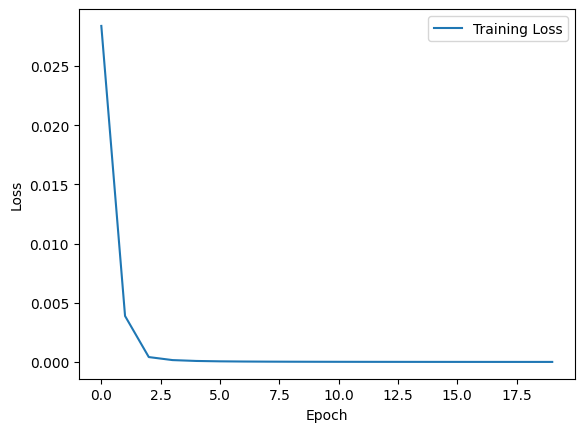

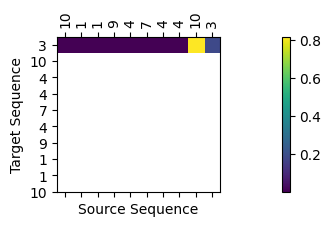

In [ ]:
import torch
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt
import random

# 1. Generate a synthetic dataset
def generate_data(num_samples=10000, seq_length=10, vocab_size=10):
    data = []
    for _ in range(num_samples):
        source = [random.randint(1, vocab_size - 1) for _ in range(seq_length)]
        target = source[::-1]  # Reverse of the source
        data.append((source, target))
    return data

def pad_sequences(sequences, pad_value=0):
    max_length = max(len(seq) for seq in sequences)
    return [seq + [pad_value] * (max_length - len(seq)) for seq in sequences]

def prepare_batch(data, batch_size, vocab_size):
    random.shuffle(data)
    for i in range(0, len(data), batch_size):
        batch = data[i:i + batch_size]
        source_seqs, target_seqs = zip(*batch)
        source_seqs = pad_sequences(source_seqs)
        target_seqs = pad_sequences(target_seqs)
        yield torch.tensor(source_seqs, dtype=torch.long), torch.tensor(target_seqs, dtype=torch.long)

# 2. Define the Seq2Seq model with attention
class Encoder(nn.Module):
    def __init__(self, input_dim, emb_dim, hidden_dim, num_layers):
        super().__init__()
        self.embedding = nn.Embedding(input_dim, emb_dim)
        self.rnn = nn.LSTM(emb_dim, hidden_dim, num_layers, batch_first=True)

    def forward(self, x):
        embedded = self.embedding(x)
        outputs, (hidden, cell) = self.rnn(embedded)
        return outputs, hidden, cell

class Attention(nn.Module):
    def __init__(self, hidden_dim):
        super().__init__()
        self.attn = nn.Linear(hidden_dim * 2, hidden_dim)
        self.v = nn.Linear(hidden_dim, 1, bias=False)

    def forward(self, encoder_outputs, hidden):
        hidden = hidden[-1].unsqueeze(1).repeat(1, encoder_outputs.size(1), 1)
        energy = torch.tanh(self.attn(torch.cat((hidden, encoder_outputs), dim=2)))
        attention = self.v(energy).squeeze(2)
        return torch.softmax(attention, dim=1)

class Decoder(nn.Module):
    def __init__(self, output_dim, emb_dim, hidden_dim, num_layers):
        super().__init__()
        self.embedding = nn.Embedding(output_dim, emb_dim)
        self.rnn = nn.LSTM(hidden_dim + emb_dim, hidden_dim, num_layers, batch_first=True)
        self.fc_out = nn.Linear(hidden_dim, output_dim)
        self.attention = Attention(hidden_dim)

    def forward(self, x, encoder_outputs, hidden, cell):
        x = x.unsqueeze(1)
        embedded = self.embedding(x)
        attention_weights = self.attention(encoder_outputs, hidden)
        context = torch.bmm(attention_weights.unsqueeze(1), encoder_outputs).squeeze(1)
        rnn_input = torch.cat((embedded.squeeze(1), context), dim=1).unsqueeze(1)
        outputs, (hidden, cell) = self.rnn(rnn_input, (hidden, cell))
        predictions = self.fc_out(outputs.squeeze(1))
        return predictions, hidden, cell, attention_weights

class Seq2Seq(nn.Module):
    def __init__(self, encoder, decoder):
        super().__init__()
        self.encoder = encoder
        self.decoder = decoder

    def forward(self, source, target, teacher_forcing_ratio=0.5):
        batch_size = source.size(0)
        target_len = target.size(1)
        target_vocab_size = self.decoder.fc_out.out_features

        outputs = torch.zeros(batch_size, target_len, target_vocab_size).to(source.device)
        encoder_outputs, hidden, cell = self.encoder(source)
        decoder_input = target[:, 0]
        all_attention_weights = []

        for t in range(1, target_len):
            # Fix: Unpack all four returned values
            output, hidden, cell, attention_weights = self.decoder(decoder_input, encoder_outputs, hidden, cell)
            outputs[:, t] = output
            all_attention_weights.append(attention_weights)
            teacher_force = random.random() < teacher_forcing_ratio
            top1 = output.argmax(1)
            decoder_input = target[:, t] if teacher_force else top1

        return outputs, all_attention_weights  # Fix: Return attention weights along with outputs


# 3. Training the model with print statements for source, target, and predicted sequences
def train_model(model, data, optimizer, criterion, epochs, batch_size, vocab_size, device):
    model.to(device)
    train_loss = []
    for epoch in range(epochs):
        model.train()
        epoch_loss = 0
        for source, target in prepare_batch(data, batch_size, vocab_size):
            source, target = source.to(device), target.to(device)
            
            optimizer.zero_grad()
            output, _ = model(source, target)  # Ignore attention weights during training
            
            output_dim = output.shape[-1]
            # Convert output to predicted token indices (most probable token at each time step)
            output = output[:, 1:].reshape(-1, output_dim)  # Flatten the output for loss computation
            target = target[:, 1:].reshape(-1)
            loss = criterion(output, target)
            
            # Get predicted tokens by taking the most probable token at each time step
            predicted = output.argmax(dim=-1)  # Take argmax along the vocabulary dimension

            # Print the source, target, and predicted sequences
            print("Source Sequence:")
            print(source.cpu().numpy())
            print("Target Sequence:")
            print(target.cpu().numpy())
            print("Predicted Sequence:")
            print(predicted.cpu().numpy())
            
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        
        train_loss.append(epoch_loss / len(data))
        print(f"Epoch {epoch + 1}/{epochs}, Loss: {epoch_loss / len(data):.4f}")
    
    return train_loss



# 4. Accuracy evaluation
def calculate_accuracy(model, data, batch_size, vocab_size, device):
    model.eval()
    total_correct = 0
    total_tokens = 0
    with torch.no_grad():
        for source, target in prepare_batch(data, batch_size, vocab_size):
            source, target = source.to(device), target.to(device)
            output, _ = model(source, target, teacher_forcing_ratio=0)  # Ignore attention weights
            predicted = output.argmax(2)  # Get the most probable tokens
            for i in range(target.size(0)):  # Iterate over each sequence
                total_correct += (predicted[i, 1:] == target[i, 1:]).sum().item()
                total_tokens += (target[i, 1:] != 0).sum().item()  # Ignore padding tokens
    return total_correct / total_tokens

# 5. Visualizing attention weights
def plot_attention(attention_weights, source_seq, target_seq):
    plt.matshow(attention_weights.cpu().numpy(), cmap='viridis')
    plt.colorbar()
    plt.xticks(range(len(source_seq)), source_seq, rotation=90)
    plt.yticks(range(len(target_seq)), target_seq)
    plt.xlabel("Source Sequence")
    plt.ylabel("Target Sequence")
    plt.show()

# Hyperparameters
INPUT_DIM = OUTPUT_DIM = 11
EMB_DIM = 32
HIDDEN_DIM = 64
NUM_LAYERS = 1
BATCH_SIZE = 64
EPOCHS = 20
SEQ_LENGTH = 10
VOCAB_SIZE = 11
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Dataset preparation
data = generate_data(num_samples=10000, seq_length=SEQ_LENGTH, vocab_size=VOCAB_SIZE)

# Initialize models, optimizer, and loss function
encoder = Encoder(INPUT_DIM, EMB_DIM, HIDDEN_DIM, NUM_LAYERS)
decoder = Decoder(OUTPUT_DIM, EMB_DIM, HIDDEN_DIM, NUM_LAYERS)
model = Seq2Seq(encoder, decoder)
optimizer = optim.Adam(model.parameters(), lr=0.001)
criterion = nn.CrossEntropyLoss(ignore_index=0)

# Train the model
train_loss = train_model(model, data, optimizer, criterion, EPOCHS, BATCH_SIZE, VOCAB_SIZE, DEVICE)

# Evaluate the model
accuracy = calculate_accuracy(model, data, BATCH_SIZE, VOCAB_SIZE, DEVICE)
print(f"Model Accuracy: {accuracy:.4f}")

# Plot loss curves
plt.plot(train_loss, label="Training Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()

# Visualize attention weights for a single example
source, target = next(prepare_batch(data, 1, VOCAB_SIZE))
source, target = source.to(DEVICE), target.to(DEVICE)

# Correctly unpack the outputs
output, attention_weights = model(source, target, teacher_forcing_ratio=0)

# Extract attention weights for plotting
attention_weights = attention_weights[0].detach().cpu()

# Plot the attention weights
plot_attention(attention_weights, source[0].cpu().tolist(), target[0].cpu().tolist())



Explanation of Output:

    Source Sequence: The original sequence fed into the model.
    Target Sequence: The correct sequence that the model should predict (which is the reverse of the source sequence).
    Predicted Sequence: The sequence that the model predicts based on the source sequence. This is generated by taking the most probable token at each step of the decoding process.

Considerations:

    The predicted sequence might not match the target sequence exactly, especially early in training, because the model is still learning.
    The loss will decrease over time as the model improves its predictions.

In [2]:
def plot_attention(attention_weights, source_seq, target_seq):
    plt.matshow(attention_weights.cpu().numpy(), cmap='viridis')
    plt.colorbar()
    plt.xticks(range(len(source_seq)), source_seq, rotation=90)
    plt.yticks(range(len(target_seq)), target_seq)
    plt.xlabel("Source Sequence")
    plt.ylabel("Target Sequence")
    plt.show()